In [ ]:
import json
import os
from datetime import datetime
from itertools import product
from os import PathLike

import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from PIL import Image
from torch.utils.data import DataLoader, Dataset
from torchmetrics.image import StructuralSimilarityIndexMeasure as SSIM
from torchvision.transforms import Compose, Resize, ToPILImage, ToTensor
from tqdm import tqdm
from utils import ImageVisualizer, MetricContainer, compute_metrics


In [ ]:
class UpscalingDataset(Dataset):
    def __init__(
        self, dataset_dir: PathLike, hr_size: tuple[int, int], lr_size: tuple[int, int]
    ):
        super(UpscalingDataset, self).__init__()
        self.image_filenames = sorted(
            [os.path.join(dataset_dir, x) for x in os.listdir(dataset_dir)]
        )
        self.hr_transform = Compose(
            [Resize(hr_size, interpolation=Image.BICUBIC), ToTensor()]
        )
        self.lr_transform = Compose(
            [ToPILImage(), Resize(lr_size, interpolation=Image.BICUBIC), ToTensor()]
        )

    def __getitem__(self, index):
        hr_image = self.hr_transform(Image.open(self.image_filenames[index]))
        lr_image = self.lr_transform(hr_image)
        return lr_image, hr_image

    def __len__(self):
        return len(self.image_filenames)


In [ ]:
class UpscalingModel(nn.Module):
    def __init__(self, scale_factor, num_residual_blocks=4, n_channels=64):
        upsample_block_num = int(np.log2(scale_factor))

        super(UpscalingModel, self).__init__()
        self.input_conv = nn.Sequential(
            nn.Conv2d(3, n_channels, kernel_size=9, padding=4), nn.PReLU()
        )
        self.residual_blocks = nn.Sequential(
            *[ResidualBlock(n_channels) for _ in range(num_residual_blocks)]
        )
        self.conv = nn.Sequential(
            nn.Conv2d(n_channels, n_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(n_channels),
        )
        upsample_blocks = [
            UpsampleBlock(n_channels, 2) for _ in range(upsample_block_num)
        ]
        upsample_blocks.append(nn.Conv2d(n_channels, 3, kernel_size=9, padding=4))
        self.upsample_blocks = nn.Sequential(*upsample_blocks)

    def forward(self, x):
        res = self.input_conv(x)
        x = self.residual_blocks(res)
        x = self.conv(x)
        upsample = self.upsample_blocks(res + x)
        return (torch.tanh(upsample) + 1) / 2


class ResidualBlock(nn.Module):
    def __init__(self, channels):
        super(ResidualBlock, self).__init__()
        self.conv1 = nn.Conv2d(channels, channels, kernel_size=3, padding=1)
        self.bn1 = nn.BatchNorm2d(channels)
        self.prelu = nn.PReLU()
        self.conv2 = nn.Conv2d(channels, channels, kernel_size=3, padding=1)
        self.bn2 = nn.BatchNorm2d(channels)

    def forward(self, x):
        residual = self.conv1(x)
        residual = self.bn1(residual)
        residual = self.prelu(residual)
        residual = self.conv2(residual)
        residual = self.bn2(residual)
        return x + residual


class UpsampleBlock(nn.Module):
    def __init__(self, in_channels, up_scale):
        super(UpsampleBlock, self).__init__()
        self.conv = nn.Conv2d(
            in_channels, in_channels * up_scale**2, kernel_size=3, padding=1
        )
        self.pixel_shuffle = nn.PixelShuffle(up_scale)
        self.prelu = nn.PReLU()

    def forward(self, x):
        x = self.conv(x)
        x = self.pixel_shuffle(x)
        x = self.prelu(x)
        return x


In [ ]:
class ModelLoss(nn.Module):
    def __init__(self, mse_weight=0.5, ssim_weight=0.5):
        super(ModelLoss, self).__init__()
        self.mse_loss = nn.MSELoss()
        self.ssim = SSIM()
        self.mse_weight = mse_weight
        self.ssim_weight = ssim_weight

    def forward(self, output, target):
        mse = self.mse_loss(output, target)
        ssim_value = self.ssim(output, target)
        ssim_loss = 1 - ssim_value
        total_loss = self.mse_weight * mse + self.ssim_weight * ssim_loss        
        return total_loss


In [ ]:
__model = UpscalingModel(scale_factor=4)
__input_tensor = torch.randn(1, 3, 64, 64)
__output_tensor = __model(__input_tensor)
print(__output_tensor.shape)


torch.Size([1, 3, 256, 256])


In [ ]:
def train(params):
    save_dirname = (
        "models/"
        + f"size_{params['lr_size'][0]}_"
        + f"res_blocks_{params['num_residual_blocks']}_"
        + f"n_channels_{params['n_channels']}_"
        + f"{datetime.now().strftime('%Y-%m-%d_%H-%M-%S')}"
    )
    os.makedirs(save_dirname, exist_ok=True)
    with open(os.path.join(save_dirname, "params.json"), "w") as f:
        json.dump(params, f, indent=4)
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    scale_factor = params["hr_size"][0] // params["lr_size"][0]
    model = UpscalingModel(
        scale_factor=scale_factor,
        num_residual_blocks=params["num_residual_blocks"],
        n_channels=params["n_channels"],
    ).to(device)
    criterion = ModelLoss(
        mse_weight=params["mse_weight"], ssim_weight=params["ssim_weight"]
    ).to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=params["learning_rate"])

    train_dataset = UpscalingDataset(
        dataset_dir=params["train_dir"],
        hr_size=params["hr_size"],
        lr_size=params["lr_size"],
    )
    valid_dataset = UpscalingDataset(
        dataset_dir=params["valid_dir"],
        hr_size=params["hr_size"],
        lr_size=params["lr_size"],
    )

    train_dataloader = DataLoader(
        train_dataset,
        batch_size=params["batch_size"],
        num_workers=params["num_workers"],
        shuffle=True,
    )
    valid_dataloader = DataLoader(
        valid_dataset,
        batch_size=params["batch_size"],
        num_workers=params["num_workers"],
        shuffle=False,
    )
    all_results = []
    for epoch in tqdm(range(params["num_epochs"]), desc="Epochs"):        
        model.train()
        for lr_image, hr_image in tqdm(train_dataloader, desc=f"Epoch {epoch + 1} - Training", leave=False):
            lr_image, hr_image = lr_image.to(device), hr_image.to(device)
            optimizer.zero_grad()
            output = model(lr_image)
            loss = criterion(output, hr_image)
            loss.backward()
            optimizer.step()

        if (epoch + 1) % params["eval_step"] == 0:
            model.eval()
            with torch.no_grad():
                valid_loss = 0
                total_metrics = MetricContainer(
                    {"SNE": 0, "PSNR": 0, "SSIM": 0, "LPIPS": 0}
                )
                for lr_image, hr_image in tqdm(valid_dataloader, desc=f"Epoch {epoch + 1} - Validation", leave=False):                    
                    lr_image, hr_image = lr_image.to(device), hr_image.to(device)
                    output = model(lr_image)
                    valid_loss += criterion(output, hr_image).item()
                    batch_size = hr_image.size(0)
                    for i in range(batch_size):
                        hr_single = hr_image[i]  # [C, H, W]
                        output_single = output[i]  # [C, H, W]

                        total_metrics += compute_metrics(hr_single, output_single)

            num_samples = len(valid_dataset)
            valid_loss /= len(valid_dataloader)
            avg_metrics = total_metrics / num_samples
            model_save_path = os.path.join(
                save_dirname,
                f"model_epoch_{epoch + 1}_psnr_{avg_metrics['PSNR'].__round__(2).__str__().replace('.', '_')}.pth",
            )
            torch.save(model.state_dict(), model_save_path)
            print(
                f"Epoch {epoch + 1:3}, Loss: {loss.item():.4f}, Valid Loss: {valid_loss:.4f}, {avg_metrics}"
            )
            all_results.append(
                {
                    "epoch": epoch + 1,
                    "loss": loss.item(),
                    "valid_loss": valid_loss,
                    "metrics": avg_metrics,
                }
            )
    with open(os.path.join(save_dirname, "results.json"), "w") as f:
        json.dump(all_results, f, indent=4)
    return model


Rozmiar: 32x32

Liczba bloków: 8

Liczba kanałów: 64 

In [ ]:
params = {
    'lr_size': (32, 32),
    'hr_size': (256, 256),
    'train_dir': 'data/train',
    'valid_dir': 'data/valid',
    'batch_size': 16,
    'num_workers': 4,
    'num_epochs': 40,
    'learning_rate': 0.001,
    'eval_step': 2,
    'mse_weight': 0.7,
    'ssim_weight': 0.3,
    'n_channels': 64,
    'num_residual_blocks': 8,
}

train(params)


Using device: cuda


Epochs:   5%|▌         | 2/40 [01:34<32:50, 51.86s/it]

Epoch   2, Loss: 0.2128, Valid Loss: 0.2198, SNE: 5763.5108, PSNR: 15.1854, SSIM: 0.3410, LPIPS: 0.8205


Epochs:  10%|█         | 4/40 [03:07<31:03, 51.76s/it]

Epoch   4, Loss: 0.1724, Valid Loss: 0.2074, SNE: 4906.0983, PSNR: 15.7878, SSIM: 0.3735, LPIPS: 0.7776


Epochs:  15%|█▌        | 6/40 [04:41<29:19, 51.74s/it]

Epoch   6, Loss: 0.2014, Valid Loss: 0.2187, SNE: 6619.3646, PSNR: 14.1110, SSIM: 0.3533, LPIPS: 0.7364


Epochs:  20%|██        | 8/40 [06:15<27:40, 51.89s/it]

Epoch   8, Loss: 0.2073, Valid Loss: 0.1969, SNE: 4384.4800, PSNR: 16.7571, SSIM: 0.4005, LPIPS: 0.7237


Epochs:  25%|██▌       | 10/40 [07:50<25:59, 51.98s/it]

Epoch  10, Loss: 0.1829, Valid Loss: 0.1962, SNE: 4281.2835, PSNR: 16.7135, SSIM: 0.4012, LPIPS: 0.7158


Epochs:  30%|███       | 12/40 [09:24<24:17, 52.04s/it]

Epoch  12, Loss: 0.1685, Valid Loss: 0.1931, SNE: 3816.7633, PSNR: 17.2000, SSIM: 0.4067, LPIPS: 0.7077


Epochs:  35%|███▌      | 14/40 [10:59<22:34, 52.09s/it]

Epoch  14, Loss: 0.2020, Valid Loss: 0.1920, SNE: 3761.9859, PSNR: 17.3242, SSIM: 0.4096, LPIPS: 0.7103


Epochs:  40%|████      | 16/40 [12:33<20:51, 52.13s/it]

Epoch  16, Loss: 0.1868, Valid Loss: 0.1903, SNE: 3783.4891, PSNR: 17.4222, SSIM: 0.4157, LPIPS: 0.6943


Epochs:  45%|████▌     | 18/40 [14:08<19:07, 52.18s/it]

Epoch  18, Loss: 0.1914, Valid Loss: 0.1896, SNE: 3451.2398, PSNR: 17.7653, SSIM: 0.4129, LPIPS: 0.7031


Epochs:  50%|█████     | 20/40 [15:43<17:24, 52.21s/it]

Epoch  20, Loss: 0.1964, Valid Loss: 0.1883, SNE: 3585.4497, PSNR: 17.6875, SSIM: 0.4196, LPIPS: 0.6910


Epochs:  55%|█████▌    | 22/40 [17:17<15:36, 52.04s/it]

Epoch  22, Loss: 0.1911, Valid Loss: 0.1882, SNE: 3594.8246, PSNR: 17.6602, SSIM: 0.4196, LPIPS: 0.6770


Epochs:  60%|██████    | 24/40 [18:51<13:53, 52.09s/it]

Epoch  24, Loss: 0.1759, Valid Loss: 0.1877, SNE: 3606.1823, PSNR: 17.6441, SSIM: 0.4217, LPIPS: 0.6821


Epochs:  65%|██████▌   | 26/40 [20:26<12:11, 52.23s/it]

Epoch  26, Loss: 0.1757, Valid Loss: 0.1870, SNE: 3533.0933, PSNR: 17.7684, SSIM: 0.4232, LPIPS: 0.6720


Epochs:  70%|███████   | 28/40 [21:59<10:19, 51.66s/it]

Epoch  28, Loss: 0.1772, Valid Loss: 0.1860, SNE: 3307.5844, PSNR: 17.9413, SSIM: 0.4236, LPIPS: 0.6697


Epochs:  75%|███████▌  | 30/40 [23:31<08:33, 51.38s/it]

Epoch  30, Loss: 0.1680, Valid Loss: 0.1871, SNE: 3626.3381, PSNR: 17.6452, SSIM: 0.4231, LPIPS: 0.6598


Epochs:  80%|████████  | 32/40 [25:04<06:49, 51.21s/it]

Epoch  32, Loss: 0.1507, Valid Loss: 0.1859, SNE: 3510.5393, PSNR: 17.7898, SSIM: 0.4264, LPIPS: 0.6705


Epochs:  85%|████████▌ | 34/40 [26:37<05:06, 51.15s/it]

Epoch  34, Loss: 0.1745, Valid Loss: 0.1868, SNE: 3430.7819, PSNR: 17.8073, SSIM: 0.4222, LPIPS: 0.6615


Epochs:  90%|█████████ | 36/40 [28:09<03:24, 51.10s/it]

Epoch  36, Loss: 0.1815, Valid Loss: 0.1850, SNE: 3321.7207, PSNR: 18.0090, SSIM: 0.4270, LPIPS: 0.6486


Epochs:  95%|█████████▌| 38/40 [29:42<01:42, 51.05s/it]

Epoch  38, Loss: 0.1836, Valid Loss: 0.1857, SNE: 3248.2572, PSNR: 18.0379, SSIM: 0.4241, LPIPS: 0.6475


Epochs: 100%|██████████| 40/40 [31:16<00:00, 46.90s/it]

Epoch  40, Loss: 0.1719, Valid Loss: 0.1851, SNE: 3542.0264, PSNR: 17.7948, SSIM: 0.4291, LPIPS: 0.6429


UpscalingModel(
  (input_conv): Sequential(
    (0): Conv2d(3, 64, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
    (1): PReLU(num_parameters=1)
  )
  (residual_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_runn

Rozmiar: 32x32

Liczba bloków: 16

Liczba kanałów: 64 

In [ ]:
params = {
    'lr_size': (32, 32),
    'hr_size': (256, 256),
    'train_dir': 'data/train',
    'valid_dir': 'data/valid',
    'batch_size': 16,
    'num_workers': 4,
    'num_epochs': 40,
    'learning_rate': 0.001,
    'eval_step': 2,
    'mse_weight': 0.7,
    'ssim_weight': 0.3,
    'n_channels': 64,
    'num_residual_blocks': 16,
}

train(params)


Using device: cuda


Epochs:   5%|▌         | 2/40 [01:39<34:47, 54.93s/it]

Epoch   2, Loss: 0.2031, Valid Loss: 0.2199, SNE: 5103.3095, PSNR: 15.4555, SSIM: 0.3316, LPIPS: 0.8376


Epochs:  10%|█         | 4/40 [03:18<32:46, 54.63s/it]

Epoch   4, Loss: 0.1955, Valid Loss: 0.2020, SNE: 4292.8949, PSNR: 16.5401, SSIM: 0.3836, LPIPS: 0.7727


Epochs:  15%|█▌        | 6/40 [04:58<31:05, 54.86s/it]

Epoch   6, Loss: 0.1889, Valid Loss: 0.1980, SNE: 4225.1076, PSNR: 16.8436, SSIM: 0.3949, LPIPS: 0.7403


Epochs:  20%|██        | 8/40 [06:38<29:19, 54.99s/it]

Epoch   8, Loss: 0.2117, Valid Loss: 0.1952, SNE: 3800.0401, PSNR: 17.1786, SSIM: 0.4005, LPIPS: 0.7366


Epochs:  25%|██▌       | 10/40 [08:16<27:19, 54.66s/it]

Epoch  10, Loss: 0.1807, Valid Loss: 0.1956, SNE: 4095.1729, PSNR: 17.0191, SSIM: 0.4021, LPIPS: 0.7098


Epochs:  30%|███       | 12/40 [09:54<25:14, 54.10s/it]

Epoch  12, Loss: 0.1933, Valid Loss: 0.1911, SNE: 3688.8531, PSNR: 17.4292, SSIM: 0.4110, LPIPS: 0.7257


Epochs:  35%|███▌      | 14/40 [11:32<23:28, 54.16s/it]

Epoch  14, Loss: 0.1780, Valid Loss: 0.1915, SNE: 3781.0324, PSNR: 17.3614, SSIM: 0.4110, LPIPS: 0.7011


Epochs:  40%|████      | 16/40 [13:12<21:50, 54.60s/it]

Epoch  16, Loss: 0.1783, Valid Loss: 0.1887, SNE: 3453.7220, PSNR: 17.7105, SSIM: 0.4164, LPIPS: 0.7065


Epochs:  45%|████▌     | 18/40 [14:51<20:06, 54.83s/it]

Epoch  18, Loss: 0.1727, Valid Loss: 0.1890, SNE: 3538.5749, PSNR: 17.6512, SSIM: 0.4176, LPIPS: 0.6969


Epochs:  50%|█████     | 20/40 [16:32<18:22, 55.11s/it]

Epoch  20, Loss: 0.1990, Valid Loss: 0.1899, SNE: 3498.7677, PSNR: 17.4683, SSIM: 0.4129, LPIPS: 0.7012


Epochs:  55%|█████▌    | 22/40 [18:13<16:36, 55.38s/it]

Epoch  22, Loss: 0.1791, Valid Loss: 0.1886, SNE: 3747.9449, PSNR: 17.4569, SSIM: 0.4197, LPIPS: 0.6870


Epochs:  60%|██████    | 24/40 [19:53<14:47, 55.46s/it]

Epoch  24, Loss: 0.1701, Valid Loss: 0.1881, SNE: 3317.0894, PSNR: 17.9117, SSIM: 0.4164, LPIPS: 0.6702


Epochs:  65%|██████▌   | 26/40 [21:32<12:48, 54.92s/it]

Epoch  26, Loss: 0.1936, Valid Loss: 0.1862, SNE: 3393.9615, PSNR: 17.8244, SSIM: 0.4239, LPIPS: 0.6737


Epochs:  70%|███████   | 28/40 [23:12<10:58, 54.88s/it]

Epoch  28, Loss: 0.1783, Valid Loss: 0.1861, SNE: 3434.1263, PSNR: 17.8367, SSIM: 0.4244, LPIPS: 0.6689


Epochs:  75%|███████▌  | 30/40 [25:01<09:33, 57.36s/it]

Epoch  30, Loss: 0.1663, Valid Loss: 0.1863, SNE: 3474.1911, PSNR: 17.7522, SSIM: 0.4244, LPIPS: 0.6731


Epochs:  80%|████████  | 32/40 [26:54<07:56, 59.59s/it]

Epoch  32, Loss: 0.1635, Valid Loss: 0.1861, SNE: 3470.8955, PSNR: 17.8273, SSIM: 0.4254, LPIPS: 0.6658


Epochs:  85%|████████▌ | 34/40 [28:47<06:04, 60.72s/it]

Epoch  34, Loss: 0.1561, Valid Loss: 0.1852, SNE: 3410.3935, PSNR: 17.8791, SSIM: 0.4271, LPIPS: 0.6659


Epochs:  90%|█████████ | 36/40 [30:43<04:08, 62.11s/it]

Epoch  36, Loss: 0.1732, Valid Loss: 0.1852, SNE: 3445.6417, PSNR: 17.8483, SSIM: 0.4277, LPIPS: 0.6521


Epochs:  95%|█████████▌| 38/40 [32:36<02:04, 62.12s/it]

Epoch  38, Loss: 0.1898, Valid Loss: 0.1862, SNE: 3334.1940, PSNR: 17.9412, SSIM: 0.4225, LPIPS: 0.6484


Epochs: 100%|██████████| 40/40 [34:28<00:00, 51.72s/it]

Epoch  40, Loss: 0.1691, Valid Loss: 0.1851, SNE: 3437.2369, PSNR: 17.8691, SSIM: 0.4282, LPIPS: 0.6428


UpscalingModel(
  (input_conv): Sequential(
    (0): Conv2d(3, 64, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
    (1): PReLU(num_parameters=1)
  )
  (residual_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_runn

Rozmiar: 32x32

Liczba bloków: 8

Liczba kanałów: 32

In [ ]:
params = {
    'lr_size': (32, 32),
    'hr_size': (256, 256),
    'train_dir': 'data/train',
    'valid_dir': 'data/valid',
    'batch_size': 16,
    'num_workers': 4,
    'num_epochs': 40,
    'learning_rate': 0.001,
    'eval_step': 2,
    'mse_weight': 0.7,
    'ssim_weight': 0.3,
    'n_channels': 32,
    'num_residual_blocks': 8,
}

train(params)


Using device: cuda


Epochs:   0%|          | 0/40 [00:00<?, ?it/s]

Epochs:   5%|▌         | 2/40 [01:43<36:45, 58.04s/it]

Epoch   2, Loss: 0.2112, Valid Loss: 0.2111, SNE: 6138.9206, PSNR: 15.2058, SSIM: 0.3703, LPIPS: 0.7488


Epochs:  10%|█         | 4/40 [03:27<34:51, 58.10s/it]

Epoch   4, Loss: 0.1950, Valid Loss: 0.2060, SNE: 4696.0361, PSNR: 16.2878, SSIM: 0.3703, LPIPS: 0.7190


Epochs:  15%|█▌        | 6/40 [05:09<32:27, 57.27s/it]

Epoch   6, Loss: 0.1839, Valid Loss: 0.1921, SNE: 3797.2182, PSNR: 17.3397, SSIM: 0.4058, LPIPS: 0.7216


Epochs:  20%|██        | 8/40 [06:52<30:36, 57.38s/it]

Epoch   8, Loss: 0.1900, Valid Loss: 0.1905, SNE: 3759.5611, PSNR: 17.3760, SSIM: 0.4106, LPIPS: 0.7188


Epochs:  25%|██▌       | 10/40 [08:36<28:52, 57.75s/it]

Epoch  10, Loss: 0.1902, Valid Loss: 0.1903, SNE: 3753.3027, PSNR: 17.3064, SSIM: 0.4111, LPIPS: 0.7103


Epochs:  30%|███       | 12/40 [10:18<26:43, 57.28s/it]

Epoch  12, Loss: 0.1745, Valid Loss: 0.1888, SNE: 3595.0962, PSNR: 17.5591, SSIM: 0.4143, LPIPS: 0.6985


Epochs:  35%|███▌      | 14/40 [11:58<24:34, 56.69s/it]

Epoch  14, Loss: 0.1692, Valid Loss: 0.1876, SNE: 3630.6811, PSNR: 17.5484, SSIM: 0.4187, LPIPS: 0.6966


Epochs:  40%|████      | 16/40 [13:42<22:54, 57.27s/it]

Epoch  16, Loss: 0.1998, Valid Loss: 0.1859, SNE: 3461.6225, PSNR: 17.7958, SSIM: 0.4220, LPIPS: 0.6959


Epochs:  45%|████▌     | 18/40 [15:28<21:20, 58.22s/it]

Epoch  18, Loss: 0.1805, Valid Loss: 0.1866, SNE: 3612.9462, PSNR: 17.6477, SSIM: 0.4221, LPIPS: 0.6858


Epochs:  50%|█████     | 20/40 [17:07<18:56, 56.80s/it]

Epoch  20, Loss: 0.2083, Valid Loss: 0.1878, SNE: 4094.3930, PSNR: 17.0803, SSIM: 0.4235, LPIPS: 0.6857


Epochs:  55%|█████▌    | 22/40 [18:48<16:59, 56.64s/it]

Epoch  22, Loss: 0.2296, Valid Loss: 0.1858, SNE: 3389.6412, PSNR: 17.8091, SSIM: 0.4216, LPIPS: 0.6666


Epochs:  60%|██████    | 24/40 [20:27<14:53, 55.86s/it]

Epoch  24, Loss: 0.1828, Valid Loss: 0.1841, SNE: 3296.5472, PSNR: 18.0309, SSIM: 0.4263, LPIPS: 0.6700


Epochs:  65%|██████▌   | 26/40 [22:07<12:59, 55.65s/it]

Epoch  26, Loss: 0.1589, Valid Loss: 0.1847, SNE: 3399.8939, PSNR: 17.8917, SSIM: 0.4255, LPIPS: 0.6667


Epochs:  70%|███████   | 28/40 [23:49<11:16, 56.36s/it]

Epoch  28, Loss: 0.1630, Valid Loss: 0.1845, SNE: 3318.2606, PSNR: 17.9871, SSIM: 0.4250, LPIPS: 0.6572


Epochs:  75%|███████▌  | 30/40 [25:26<09:10, 55.07s/it]

Epoch  30, Loss: 0.1540, Valid Loss: 0.1844, SNE: 3575.4663, PSNR: 17.7253, SSIM: 0.4285, LPIPS: 0.6573


Epochs:  80%|████████  | 32/40 [27:04<07:18, 54.83s/it]

Epoch  32, Loss: 0.1894, Valid Loss: 0.1848, SNE: 3407.2268, PSNR: 17.8986, SSIM: 0.4250, LPIPS: 0.6571


Epochs:  85%|████████▌ | 34/40 [28:37<05:20, 53.48s/it]

Epoch  34, Loss: 0.1845, Valid Loss: 0.1829, SNE: 3379.7132, PSNR: 17.9323, SSIM: 0.4313, LPIPS: 0.6463


Epochs:  90%|█████████ | 36/40 [30:22<03:44, 56.09s/it]

Epoch  36, Loss: 0.1760, Valid Loss: 0.1840, SNE: 3417.9277, PSNR: 17.8144, SSIM: 0.4276, LPIPS: 0.6497


Epochs:  95%|█████████▌| 38/40 [32:06<01:54, 57.19s/it]

Epoch  38, Loss: 0.1671, Valid Loss: 0.1824, SNE: 3324.6556, PSNR: 17.9741, SSIM: 0.4320, LPIPS: 0.6466


Epochs: 100%|██████████| 40/40 [33:47<00:00, 50.70s/it]

Epoch  40, Loss: 0.1280, Valid Loss: 0.1829, SNE: 3534.2142, PSNR: 17.7650, SSIM: 0.4329, LPIPS: 0.6489


UpscalingModel(
  (input_conv): Sequential(
    (0): Conv2d(3, 32, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
    (1): PReLU(num_parameters=1)
  )
  (residual_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_runn

Rozmiar: 32x32

Liczba bloków: 16

Liczba kanałów: 32

In [ ]:
params = {
    'lr_size': (32, 32),
    'hr_size': (256, 256),
    'train_dir': 'data/train',
    'valid_dir': 'data/valid',
    'batch_size': 16,
    'num_workers': 4,
    'num_epochs': 40,
    'learning_rate': 0.001,
    'eval_step': 2,
    'mse_weight': 0.7,
    'ssim_weight': 0.3,
    'n_channels': 32,
    'num_residual_blocks': 16,
}

train(params)


Using device: cuda


Epochs:   0%|          | 0/40 [00:00<?, ?it/s]

Epochs:   5%|▌         | 2/40 [01:31<31:58, 50.49s/it]

Epoch   2, Loss: 0.1896, Valid Loss: 0.2159, SNE: 5440.3181, PSNR: 15.5937, SSIM: 0.3497, LPIPS: 0.8133


Epochs:  10%|█         | 4/40 [03:02<30:29, 50.81s/it]

Epoch   4, Loss: 0.2282, Valid Loss: 0.2066, SNE: 5189.3636, PSNR: 15.9469, SSIM: 0.3770, LPIPS: 0.7441


Epochs:  15%|█▌        | 6/40 [04:34<28:43, 50.70s/it]

Epoch   6, Loss: 0.1960, Valid Loss: 0.2094, SNE: 5516.9584, PSNR: 15.6111, SSIM: 0.3714, LPIPS: 0.7312


Epochs:  20%|██        | 8/40 [06:05<27:05, 50.80s/it]

Epoch   8, Loss: 0.1814, Valid Loss: 0.1940, SNE: 3928.1834, PSNR: 17.2144, SSIM: 0.4048, LPIPS: 0.7352


Epochs:  25%|██▌       | 10/40 [07:37<25:26, 50.87s/it]

Epoch  10, Loss: 0.1881, Valid Loss: 0.1938, SNE: 3949.5398, PSNR: 17.1675, SSIM: 0.4062, LPIPS: 0.7304


Epochs:  30%|███       | 12/40 [09:09<23:43, 50.84s/it]

Epoch  12, Loss: 0.1784, Valid Loss: 0.1948, SNE: 4292.5002, PSNR: 16.8547, SSIM: 0.4069, LPIPS: 0.7217


Epochs:  35%|███▌      | 14/40 [10:40<22:01, 50.82s/it]

Epoch  14, Loss: 0.2014, Valid Loss: 0.1907, SNE: 3776.0782, PSNR: 17.4317, SSIM: 0.4141, LPIPS: 0.7280


Epochs:  40%|████      | 16/40 [12:12<20:23, 50.98s/it]

Epoch  16, Loss: 0.1905, Valid Loss: 0.1896, SNE: 3545.4238, PSNR: 17.6221, SSIM: 0.4142, LPIPS: 0.7100


Epochs:  45%|████▌     | 18/40 [13:45<18:46, 51.22s/it]

Epoch  18, Loss: 0.1853, Valid Loss: 0.1896, SNE: 3745.3014, PSNR: 17.4216, SSIM: 0.4164, LPIPS: 0.6983


Epochs:  50%|█████     | 20/40 [15:20<17:18, 51.91s/it]

Epoch  20, Loss: 0.1814, Valid Loss: 0.1881, SNE: 3436.5527, PSNR: 17.6344, SSIM: 0.4179, LPIPS: 0.7047


Epochs:  55%|█████▌    | 22/40 [16:55<15:43, 52.41s/it]

Epoch  22, Loss: 0.1964, Valid Loss: 0.1894, SNE: 3607.8325, PSNR: 17.5122, SSIM: 0.4156, LPIPS: 0.6997


Epochs:  60%|██████    | 24/40 [18:30<14:01, 52.57s/it]

Epoch  24, Loss: 0.1803, Valid Loss: 0.1875, SNE: 3562.6547, PSNR: 17.6645, SSIM: 0.4220, LPIPS: 0.6927


Epochs:  65%|██████▌   | 26/40 [20:04<12:14, 52.48s/it]

Epoch  26, Loss: 0.1797, Valid Loss: 0.1866, SNE: 3498.4750, PSNR: 17.7156, SSIM: 0.4237, LPIPS: 0.6841


Epochs:  70%|███████   | 28/40 [21:37<10:25, 52.16s/it]

Epoch  28, Loss: 0.1812, Valid Loss: 0.1869, SNE: 3266.2428, PSNR: 17.9692, SSIM: 0.4200, LPIPS: 0.6853


Epochs:  75%|███████▌  | 30/40 [23:12<08:42, 52.22s/it]

Epoch  30, Loss: 0.1909, Valid Loss: 0.1860, SNE: 3460.5686, PSNR: 17.7788, SSIM: 0.4256, LPIPS: 0.6826


Epochs:  80%|████████  | 32/40 [24:47<06:59, 52.50s/it]

Epoch  32, Loss: 0.1745, Valid Loss: 0.1860, SNE: 3495.6935, PSNR: 17.8024, SSIM: 0.4258, LPIPS: 0.6739


Epochs:  85%|████████▌ | 34/40 [26:20<05:13, 52.27s/it]

Epoch  34, Loss: 0.1737, Valid Loss: 0.1851, SNE: 3341.7863, PSNR: 17.9958, SSIM: 0.4272, LPIPS: 0.6690


Epochs:  90%|█████████ | 36/40 [27:54<03:28, 52.14s/it]

Epoch  36, Loss: 0.1498, Valid Loss: 0.1853, SNE: 3402.1454, PSNR: 17.8766, SSIM: 0.4268, LPIPS: 0.6728


Epochs:  95%|█████████▌| 38/40 [29:27<01:43, 51.97s/it]

Epoch  38, Loss: 0.1898, Valid Loss: 0.1846, SNE: 3468.1263, PSNR: 17.8536, SSIM: 0.4301, LPIPS: 0.6604


Epochs: 100%|██████████| 40/40 [31:01<00:00, 46.53s/it]

Epoch  40, Loss: 0.1650, Valid Loss: 0.1849, SNE: 3463.3774, PSNR: 17.7962, SSIM: 0.4293, LPIPS: 0.6678


UpscalingModel(
  (input_conv): Sequential(
    (0): Conv2d(3, 32, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
    (1): PReLU(num_parameters=1)
  )
  (residual_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_runn

Rozmiar: 64x64

Liczba bloków: 8

Liczba kanałów: 64 

In [ ]:
params = {
    'lr_size': (64, 64),
    'hr_size': (256, 256),
    'train_dir': 'data/train',
    'valid_dir': 'data/valid',
    'batch_size': 16,
    'num_workers': 4,
    'num_epochs': 40,
    'learning_rate': 0.001,
    'eval_step': 2,
    'mse_weight': 0.7,
    'ssim_weight': 0.3,
    'n_channels': 64,
    'num_residual_blocks': 8,
}

train(params)


Using device: cuda


Epochs:   5%|▌         | 2/40 [01:41<35:23, 55.89s/it]

Epoch   2, Loss: 0.1668, Valid Loss: 0.1658, SNE: 3722.9342, PSNR: 17.2309, SSIM: 0.4985, LPIPS: 0.6127


Epochs:  10%|█         | 4/40 [03:26<34:15, 57.09s/it]

Epoch   4, Loss: 0.1704, Valid Loss: 0.1523, SNE: 2982.5562, PSNR: 18.5785, SSIM: 0.5346, LPIPS: 0.5474


Epochs:  15%|█▌        | 6/40 [05:09<32:02, 56.54s/it]

Epoch   6, Loss: 0.1357, Valid Loss: 0.1500, SNE: 3185.2098, PSNR: 18.1740, SSIM: 0.5437, LPIPS: 0.5541


Epochs:  20%|██        | 8/40 [06:53<30:23, 56.99s/it]

Epoch   8, Loss: 0.1307, Valid Loss: 0.1436, SNE: 2565.0107, PSNR: 19.0803, SSIM: 0.5574, LPIPS: 0.5402


Epochs:  25%|██▌       | 10/40 [08:39<28:47, 57.57s/it]

Epoch  10, Loss: 0.1401, Valid Loss: 0.1639, SNE: 5675.3941, PSNR: 15.8254, SSIM: 0.5240, LPIPS: 0.5664


Epochs:  30%|███       | 12/40 [10:24<26:55, 57.69s/it]

Epoch  12, Loss: 0.1349, Valid Loss: 0.1390, SNE: 2667.7795, PSNR: 19.1142, SSIM: 0.5744, LPIPS: 0.5105


Epochs:  35%|███▌      | 14/40 [12:09<24:55, 57.52s/it]

Epoch  14, Loss: 0.1471, Valid Loss: 0.1384, SNE: 2646.6043, PSNR: 19.2281, SSIM: 0.5756, LPIPS: 0.5051


Epochs:  40%|████      | 16/40 [13:53<23:00, 57.50s/it]

Epoch  16, Loss: 0.1284, Valid Loss: 0.1374, SNE: 2593.4381, PSNR: 19.2612, SSIM: 0.5789, LPIPS: 0.5018


Epochs:  45%|████▌     | 18/40 [15:37<21:01, 57.34s/it]

Epoch  18, Loss: 0.1379, Valid Loss: 0.1352, SNE: 2391.6664, PSNR: 19.7188, SSIM: 0.5830, LPIPS: 0.4858


Epochs:  50%|█████     | 20/40 [17:21<19:03, 57.15s/it]

Epoch  20, Loss: 0.1353, Valid Loss: 0.1347, SNE: 2486.1334, PSNR: 19.5079, SSIM: 0.5859, LPIPS: 0.4929


Epochs:  55%|█████▌    | 22/40 [19:07<17:16, 57.59s/it]

Epoch  22, Loss: 0.1252, Valid Loss: 0.1343, SNE: 2597.8925, PSNR: 19.2906, SSIM: 0.5887, LPIPS: 0.4980


Epochs:  60%|██████    | 24/40 [20:51<15:16, 57.25s/it]

Epoch  24, Loss: 0.1382, Valid Loss: 0.1329, SNE: 2375.3553, PSNR: 19.7894, SSIM: 0.5908, LPIPS: 0.4822


Epochs:  65%|██████▌   | 26/40 [22:35<13:20, 57.18s/it]

Epoch  26, Loss: 0.1385, Valid Loss: 0.1348, SNE: 2492.4230, PSNR: 19.4497, SSIM: 0.5853, LPIPS: 0.4906


Epochs:  70%|███████   | 28/40 [24:19<11:28, 57.36s/it]

Epoch  28, Loss: 0.1140, Valid Loss: 0.1319, SNE: 2304.7852, PSNR: 19.9363, SSIM: 0.5927, LPIPS: 0.4781


Epochs:  75%|███████▌  | 30/40 [26:03<09:31, 57.10s/it]

Epoch  30, Loss: 0.1258, Valid Loss: 0.1339, SNE: 2327.5353, PSNR: 19.8905, SSIM: 0.5860, LPIPS: 0.4667


Epochs:  80%|████████  | 32/40 [27:46<07:34, 56.80s/it]

Epoch  32, Loss: 0.1394, Valid Loss: 0.1329, SNE: 2470.0657, PSNR: 19.5499, SSIM: 0.5914, LPIPS: 0.4776


Epochs:  85%|████████▌ | 34/40 [29:30<05:41, 56.93s/it]

Epoch  34, Loss: 0.1371, Valid Loss: 0.1308, SNE: 2459.9751, PSNR: 19.6060, SSIM: 0.5984, LPIPS: 0.4771


Epochs:  90%|█████████ | 36/40 [31:13<03:47, 56.92s/it]

Epoch  36, Loss: 0.1381, Valid Loss: 0.1306, SNE: 2381.9189, PSNR: 19.7853, SSIM: 0.5979, LPIPS: 0.4693


Epochs:  95%|█████████▌| 38/40 [32:56<01:53, 56.70s/it]

Epoch  38, Loss: 0.1195, Valid Loss: 0.1303, SNE: 2448.7418, PSNR: 19.6864, SSIM: 0.5994, LPIPS: 0.4701


Epochs: 100%|██████████| 40/40 [34:40<00:00, 52.01s/it]

Epoch  40, Loss: 0.1333, Valid Loss: 0.1306, SNE: 2432.9905, PSNR: 19.6588, SSIM: 0.5988, LPIPS: 0.4667


UpscalingModel(
  (input_conv): Sequential(
    (0): Conv2d(3, 64, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
    (1): PReLU(num_parameters=1)
  )
  (residual_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_runn

Rozmiar: 64x64

Liczba bloków: 16

Liczba kanałów: 64 

In [ ]:
params = {
    'lr_size': (64, 64),
    'hr_size': (256, 256),
    'train_dir': 'data/train',
    'valid_dir': 'data/valid',
    'batch_size': 8,
    'num_workers': 4,
    'num_epochs': 40,
    'learning_rate': 0.001,
    'eval_step': 2,
    'mse_weight': 0.7,
    'ssim_weight': 0.3,
    'n_channels': 64,
    'num_residual_blocks': 16,
}

train(params)


Using device: cuda


Epochs:   5%|▌         | 2/40 [01:57<40:15, 63.57s/it]

Epoch   2, Loss: 0.1782, Valid Loss: 0.1678, SNE: 4401.7354, PSNR: 16.5667, SSIM: 0.4935, LPIPS: 0.5723


Epochs:  10%|█         | 4/40 [03:53<37:55, 63.22s/it]

Epoch   4, Loss: 0.1474, Valid Loss: 0.1468, SNE: 2731.1462, PSNR: 18.9715, SSIM: 0.5448, LPIPS: 0.5436


Epochs:  15%|█▌        | 6/40 [05:49<35:43, 63.05s/it]

Epoch   6, Loss: 0.1483, Valid Loss: 0.1395, SNE: 2559.2608, PSNR: 19.2348, SSIM: 0.5667, LPIPS: 0.5332


Epochs:  20%|██        | 8/40 [07:45<33:44, 63.28s/it]

Epoch   8, Loss: 0.1276, Valid Loss: 0.1378, SNE: 2598.4973, PSNR: 19.2378, SSIM: 0.5729, LPIPS: 0.5171


Epochs:  25%|██▌       | 10/40 [09:42<31:37, 63.25s/it]

Epoch  10, Loss: 0.1463, Valid Loss: 0.1365, SNE: 2472.8635, PSNR: 19.3654, SSIM: 0.5757, LPIPS: 0.5102


Epochs:  30%|███       | 12/40 [11:39<29:33, 63.36s/it]

Epoch  12, Loss: 0.1318, Valid Loss: 0.1341, SNE: 2480.4212, PSNR: 19.4924, SSIM: 0.5838, LPIPS: 0.5036


Epochs:  35%|███▌      | 14/40 [13:35<27:26, 63.34s/it]

Epoch  14, Loss: 0.1137, Valid Loss: 0.1325, SNE: 2456.2094, PSNR: 19.5765, SSIM: 0.5889, LPIPS: 0.4892


Epochs:  40%|████      | 16/40 [15:31<25:13, 63.05s/it]

Epoch  16, Loss: 0.1327, Valid Loss: 0.1324, SNE: 2323.9456, PSNR: 19.8570, SSIM: 0.5874, LPIPS: 0.4826


Epochs:  45%|████▌     | 18/40 [17:46<24:52, 67.85s/it]

Epoch  18, Loss: 0.1443, Valid Loss: 0.1309, SNE: 2389.3258, PSNR: 19.7693, SSIM: 0.5933, LPIPS: 0.4814


Epochs:  50%|█████     | 20/40 [20:00<23:18, 69.91s/it]

Epoch  20, Loss: 0.1381, Valid Loss: 0.1307, SNE: 2509.2971, PSNR: 19.4823, SSIM: 0.5955, LPIPS: 0.4784


Epochs:  55%|█████▌    | 22/40 [22:13<21:17, 70.95s/it]

Epoch  22, Loss: 0.1236, Valid Loss: 0.1299, SNE: 2247.4262, PSNR: 20.0813, SSIM: 0.5950, LPIPS: 0.4693


Epochs:  60%|██████    | 24/40 [24:21<18:31, 69.46s/it]

Epoch  24, Loss: 0.1315, Valid Loss: 0.1295, SNE: 2422.0858, PSNR: 19.6919, SSIM: 0.5984, LPIPS: 0.4748


Epochs:  65%|██████▌   | 26/40 [26:17<15:28, 66.34s/it]

Epoch  26, Loss: 0.1293, Valid Loss: 0.1284, SNE: 2334.8877, PSNR: 19.9001, SSIM: 0.6010, LPIPS: 0.4641


Epochs:  70%|███████   | 28/40 [28:15<13:00, 65.04s/it]

Epoch  28, Loss: 0.1197, Valid Loss: 0.1288, SNE: 2417.6920, PSNR: 19.7626, SSIM: 0.6005, LPIPS: 0.4610


Epochs:  75%|███████▌  | 30/40 [30:11<10:40, 64.09s/it]

Epoch  30, Loss: 0.1009, Valid Loss: 0.1276, SNE: 2212.7483, PSNR: 20.1191, SSIM: 0.6019, LPIPS: 0.4578


Epochs:  80%|████████  | 32/40 [32:08<08:30, 63.75s/it]

Epoch  32, Loss: 0.1322, Valid Loss: 0.1283, SNE: 2327.5640, PSNR: 19.9298, SSIM: 0.6010, LPIPS: 0.4615


Epochs:  85%|████████▌ | 34/40 [34:04<06:20, 63.48s/it]

Epoch  34, Loss: 0.1127, Valid Loss: 0.1279, SNE: 2360.0349, PSNR: 19.8110, SSIM: 0.6026, LPIPS: 0.4614


Epochs:  90%|█████████ | 36/40 [36:01<04:13, 63.45s/it]

Epoch  36, Loss: 0.1360, Valid Loss: 0.1283, SNE: 2479.5153, PSNR: 19.6349, SSIM: 0.6029, LPIPS: 0.4648


Epochs:  95%|█████████▌| 38/40 [37:58<02:06, 63.48s/it]

Epoch  38, Loss: 0.1108, Valid Loss: 0.1268, SNE: 2284.5523, PSNR: 20.0735, SSIM: 0.6054, LPIPS: 0.4559


Epochs: 100%|██████████| 40/40 [39:55<00:00, 59.89s/it]

Epoch  40, Loss: 0.1074, Valid Loss: 0.1272, SNE: 2386.4195, PSNR: 19.8100, SSIM: 0.6054, LPIPS: 0.4587


UpscalingModel(
  (input_conv): Sequential(
    (0): Conv2d(3, 64, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
    (1): PReLU(num_parameters=1)
  )
  (residual_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): ResidualBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_runn

Rozmiar: 64x64

Liczba bloków: 8

Liczba kanałów: 32

In [ ]:
params = {
    'lr_size': (64, 64),
    'hr_size': (256, 256),
    'train_dir': 'data/train',
    'valid_dir': 'data/valid',
    'batch_size': 16,
    'num_workers': 4,
    'num_epochs': 40,
    'learning_rate': 0.001,
    'eval_step': 2,
    'mse_weight': 0.7,
    'ssim_weight': 0.3,
    'n_channels': 32,
    'num_residual_blocks': 8,
}

train(params)


Using device: cuda


Epochs:   5%|▌         | 2/40 [01:34<33:17, 52.55s/it]

Epoch   2, Loss: 0.1501, Valid Loss: 0.1686, SNE: 4281.8032, PSNR: 16.5999, SSIM: 0.4973, LPIPS: 0.6004


Epochs:  10%|█         | 4/40 [03:16<33:06, 55.19s/it]

Epoch   4, Loss: 0.1497, Valid Loss: 0.1553, SNE: 3541.3855, PSNR: 17.5356, SSIM: 0.5311, LPIPS: 0.5723


Epochs:  15%|█▌        | 6/40 [04:55<31:09, 54.98s/it]

Epoch   6, Loss: 0.1364, Valid Loss: 0.1643, SNE: 3977.9453, PSNR: 17.1689, SSIM: 0.5067, LPIPS: 0.5655


Epochs:  20%|██        | 8/40 [06:32<29:03, 54.49s/it]

Epoch   8, Loss: 0.1330, Valid Loss: 0.1474, SNE: 3043.4186, PSNR: 18.4041, SSIM: 0.5507, LPIPS: 0.5640


Epochs:  25%|██▌       | 10/40 [08:09<27:02, 54.08s/it]

Epoch  10, Loss: 0.1218, Valid Loss: 0.1433, SNE: 2669.8742, PSNR: 19.0581, SSIM: 0.5597, LPIPS: 0.5412


Epochs:  30%|███       | 12/40 [09:46<25:09, 53.93s/it]

Epoch  12, Loss: 0.1398, Valid Loss: 0.1446, SNE: 2914.7164, PSNR: 18.6679, SSIM: 0.5590, LPIPS: 0.5304


Epochs:  35%|███▌      | 14/40 [11:23<23:16, 53.73s/it]

Epoch  14, Loss: 0.1261, Valid Loss: 0.1415, SNE: 2736.4906, PSNR: 19.0207, SSIM: 0.5677, LPIPS: 0.5219


Epochs:  40%|████      | 16/40 [13:00<21:27, 53.64s/it]

Epoch  16, Loss: 0.1375, Valid Loss: 0.1374, SNE: 2547.3236, PSNR: 19.4442, SSIM: 0.5782, LPIPS: 0.5199


Epochs:  45%|████▌     | 18/40 [14:36<19:39, 53.61s/it]

Epoch  18, Loss: 0.1383, Valid Loss: 0.1379, SNE: 2473.2661, PSNR: 19.4129, SSIM: 0.5752, LPIPS: 0.5071


Epochs:  50%|█████     | 20/40 [16:13<17:53, 53.69s/it]

Epoch  20, Loss: 0.1215, Valid Loss: 0.1381, SNE: 2703.4981, PSNR: 19.0922, SSIM: 0.5771, LPIPS: 0.5066


Epochs:  55%|█████▌    | 22/40 [17:50<16:07, 53.77s/it]

Epoch  22, Loss: 0.1545, Valid Loss: 0.1354, SNE: 2356.3067, PSNR: 19.7082, SSIM: 0.5824, LPIPS: 0.4963


Epochs:  60%|██████    | 24/40 [19:28<14:23, 53.96s/it]

Epoch  24, Loss: 0.1482, Valid Loss: 0.1360, SNE: 2470.4844, PSNR: 19.5039, SSIM: 0.5816, LPIPS: 0.4994


Epochs:  65%|██████▌   | 26/40 [21:05<12:32, 53.76s/it]

Epoch  26, Loss: 0.1277, Valid Loss: 0.1351, SNE: 2478.5136, PSNR: 19.4979, SSIM: 0.5848, LPIPS: 0.4990


Epochs:  70%|███████   | 28/40 [22:41<10:44, 53.70s/it]

Epoch  28, Loss: 0.1411, Valid Loss: 0.1343, SNE: 2547.9921, PSNR: 19.3781, SSIM: 0.5877, LPIPS: 0.5009


Epochs:  75%|███████▌  | 30/40 [24:20<09:01, 54.18s/it]

Epoch  30, Loss: 0.1176, Valid Loss: 0.1346, SNE: 2423.3189, PSNR: 19.6175, SSIM: 0.5853, LPIPS: 0.4825


Epochs:  80%|████████  | 32/40 [26:00<07:19, 54.99s/it]

Epoch  32, Loss: 0.1324, Valid Loss: 0.1358, SNE: 2711.5138, PSNR: 19.0681, SSIM: 0.5849, LPIPS: 0.5021


Epochs:  85%|████████▌ | 34/40 [27:37<05:26, 54.42s/it]

Epoch  34, Loss: 0.1200, Valid Loss: 0.1335, SNE: 2369.6785, PSNR: 19.6896, SSIM: 0.5882, LPIPS: 0.4863


Epochs:  90%|█████████ | 36/40 [29:13<03:34, 53.75s/it]

Epoch  36, Loss: 0.1491, Valid Loss: 0.1333, SNE: 2372.6458, PSNR: 19.7467, SSIM: 0.5890, LPIPS: 0.4825


Epochs:  95%|█████████▌| 38/40 [30:49<01:47, 53.58s/it]

Epoch  38, Loss: 0.1246, Valid Loss: 0.1320, SNE: 2405.5085, PSNR: 19.7264, SSIM: 0.5939, LPIPS: 0.4815


Epochs: 100%|██████████| 40/40 [32:26<00:00, 48.67s/it]

Epoch  40, Loss: 0.1406, Valid Loss: 0.1337, SNE: 2464.2009, PSNR: 19.4276, SSIM: 0.5892, LPIPS: 0.4764


UpscalingModel(
  (input_conv): Sequential(
    (0): Conv2d(3, 32, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
    (1): PReLU(num_parameters=1)
  )
  (residual_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_runn

Rozmiar: 64x64

Liczba bloków: 16

Liczba kanałów: 32

In [ ]:
params = {
    'lr_size': (64, 64),
    'hr_size': (256, 256),
    'train_dir': 'data/train',
    'valid_dir': 'data/valid',
    'batch_size': 16,
    'num_workers': 4,
    'num_epochs': 40,
    'learning_rate': 0.001,
    'eval_step': 2,
    'mse_weight': 0.7,
    'ssim_weight': 0.3,
    'n_channels': 32,
    'num_residual_blocks': 16,
}

train(params)


Using device: cuda


Epochs:   5%|▌         | 2/40 [01:41<35:37, 56.25s/it]

Epoch   2, Loss: 0.1567, Valid Loss: 0.1809, SNE: 6178.1756, PSNR: 15.3453, SSIM: 0.4760, LPIPS: 0.6208


Epochs:  10%|█         | 4/40 [03:23<33:46, 56.28s/it]

Epoch   4, Loss: 0.1508, Valid Loss: 0.1559, SNE: 3270.9549, PSNR: 18.0764, SSIM: 0.5265, LPIPS: 0.5749


Epochs:  15%|█▌        | 6/40 [05:05<31:51, 56.23s/it]

Epoch   6, Loss: 0.1448, Valid Loss: 0.1496, SNE: 3070.3695, PSNR: 18.3809, SSIM: 0.5456, LPIPS: 0.5707


Epochs:  20%|██        | 8/40 [06:47<30:00, 56.27s/it]

Epoch   8, Loss: 0.1426, Valid Loss: 0.1462, SNE: 2892.4108, PSNR: 18.6718, SSIM: 0.5549, LPIPS: 0.5609


Epochs:  25%|██▌       | 10/40 [08:30<28:20, 56.69s/it]

Epoch  10, Loss: 0.1491, Valid Loss: 0.1439, SNE: 2779.1387, PSNR: 18.8048, SSIM: 0.5587, LPIPS: 0.5433


Epochs:  30%|███       | 12/40 [10:10<26:04, 55.87s/it]

Epoch  12, Loss: 0.1407, Valid Loss: 0.1410, SNE: 2610.5269, PSNR: 19.0979, SSIM: 0.5669, LPIPS: 0.5266


Epochs:  35%|███▌      | 14/40 [11:50<24:02, 55.49s/it]

Epoch  14, Loss: 0.1471, Valid Loss: 0.1387, SNE: 2538.8018, PSNR: 19.3815, SSIM: 0.5735, LPIPS: 0.5244


Epochs:  40%|████      | 16/40 [13:31<22:10, 55.42s/it]

Epoch  16, Loss: 0.1526, Valid Loss: 0.1374, SNE: 2463.3326, PSNR: 19.5273, SSIM: 0.5774, LPIPS: 0.5172


Epochs:  45%|████▌     | 18/40 [15:12<20:27, 55.79s/it]

Epoch  18, Loss: 0.1514, Valid Loss: 0.1373, SNE: 2654.1298, PSNR: 19.2416, SSIM: 0.5797, LPIPS: 0.5075


Epochs:  50%|█████     | 20/40 [16:53<18:36, 55.82s/it]

Epoch  20, Loss: 0.1151, Valid Loss: 0.1375, SNE: 2419.5148, PSNR: 19.5249, SSIM: 0.5757, LPIPS: 0.5039


Epochs:  55%|█████▌    | 22/40 [18:35<16:48, 56.03s/it]

Epoch  22, Loss: 0.1364, Valid Loss: 0.1374, SNE: 2700.3276, PSNR: 19.0925, SSIM: 0.5796, LPIPS: 0.5061


Epochs:  60%|██████    | 24/40 [20:18<15:01, 56.34s/it]

Epoch  24, Loss: 0.1449, Valid Loss: 0.1342, SNE: 2420.0441, PSNR: 19.7093, SSIM: 0.5867, LPIPS: 0.4950


Epochs:  65%|██████▌   | 26/40 [22:00<13:10, 56.49s/it]

Epoch  26, Loss: 0.1323, Valid Loss: 0.1342, SNE: 2401.5645, PSNR: 19.6219, SSIM: 0.5867, LPIPS: 0.4922


Epochs:  70%|███████   | 28/40 [23:42<11:17, 56.42s/it]

Epoch  28, Loss: 0.1274, Valid Loss: 0.1348, SNE: 2389.2254, PSNR: 19.7222, SSIM: 0.5844, LPIPS: 0.4812


Epochs:  75%|███████▌  | 30/40 [25:25<09:26, 56.62s/it]

Epoch  30, Loss: 0.1223, Valid Loss: 0.1336, SNE: 2497.5176, PSNR: 19.5301, SSIM: 0.5892, LPIPS: 0.4859


Epochs:  80%|████████  | 32/40 [27:08<07:33, 56.64s/it]

Epoch  32, Loss: 0.1334, Valid Loss: 0.1326, SNE: 2497.0239, PSNR: 19.4866, SSIM: 0.5930, LPIPS: 0.4874


Epochs:  85%|████████▌ | 34/40 [28:51<05:40, 56.74s/it]

Epoch  34, Loss: 0.1152, Valid Loss: 0.1324, SNE: 2403.8527, PSNR: 19.6965, SSIM: 0.5927, LPIPS: 0.4876


Epochs:  90%|█████████ | 36/40 [30:33<03:46, 56.73s/it]

Epoch  36, Loss: 0.1249, Valid Loss: 0.1309, SNE: 2377.2500, PSNR: 19.7725, SSIM: 0.5974, LPIPS: 0.4803


Epochs:  95%|█████████▌| 38/40 [32:16<01:53, 56.78s/it]

Epoch  38, Loss: 0.1181, Valid Loss: 0.1314, SNE: 2536.0345, PSNR: 19.5032, SSIM: 0.5975, LPIPS: 0.4834


Epochs: 100%|██████████| 40/40 [33:59<00:00, 50.98s/it]

Epoch  40, Loss: 0.1189, Valid Loss: 0.1305, SNE: 2528.1138, PSNR: 19.5354, SSIM: 0.6001, LPIPS: 0.4806


UpscalingModel(
  (input_conv): Sequential(
    (0): Conv2d(3, 32, kernel_size=(9, 9), stride=(1, 1), padding=(4, 4))
    (1): PReLU(num_parameters=1)
  )
  (residual_blocks): Sequential(
    (0): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): ResidualBlock(
      (conv1): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (prelu): PReLU(num_parameters=1)
      (conv2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (bn2): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_runn

In [ ]:
def evaluate_model(
    dataloader: DataLoader,
    model: nn.Module,
    n_images: int = None
):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    visualizer = ImageVisualizer(["Low Resolution", "Original High Resolution", "Bicubic Interpolation", "Model Output"])
    
    all_bicubic_metrics = MetricContainer({"SNE": 0, "PSNR": 0, "SSIM": 0, "LPIPS": 0})
    all_model_metrics = MetricContainer({"SNE": 0, "PSNR": 0, "SSIM": 0, "LPIPS": 0})
    
    total_images_processed = 0
    total_images_displayed = 0
    
    model.eval()
    with torch.no_grad():
        for batch_idx, (lr_images, hr_images) in enumerate(dataloader):
            batch_size = lr_images.shape[0]  # Rozmiar batcha (np. 32)
            
            # Przeniesienie batcha na urządzenie
            lr_images = lr_images.to(device)  # [B, C, H_lr, W_lr]
            hr_images = hr_images.to(device)  # [B, C, H_hr, W_hr]

            # Skalowanie obrazów LR do rozmiaru HR za pomocą interpolacji bikubicznej
            hr_size = hr_images.shape[2:]  # [H_hr, W_hr]
            bicubic_transform = Resize(hr_size, interpolation=Image.BICUBIC)
            bicubic_images = bicubic_transform(lr_images)  # [B, C, H_hr, W_hr]

            # Obliczenie wyniku modelu dla całego batcha
            model_outputs = model(lr_images)  # [B, C, H_hr, W_hr]

            # Obliczanie metryk dla całego batcha
            all_bicubic_metrics += compute_metrics(bicubic_images, hr_images)
            all_model_metrics += compute_metrics(model_outputs, hr_images)

            # Wizualizacja dla wybranych obrazów
            if n_images is not None and total_images_displayed < n_images:
                for i in range(min(batch_size, n_images - total_images_displayed)):
                    # Przekształcenie do formatu [H, W, C] dla numpy i matplotlib
                    lr_image_np = lr_images[i].permute(1, 2, 0).cpu().numpy()  # [H_lr, W_lr, C]
                    hr_image_np = hr_images[i].permute(1, 2, 0).cpu().numpy()  # [H_hr, W_hr, C]
                    bicubic_image_np = bicubic_images[i].permute(1, 2, 0).cpu().numpy()  # [H_hr, W_hr, C]
                    model_output_np = model_outputs[i].permute(1, 2, 0).cpu().numpy()  # [H_hr, W_hr, C]

                    visualizer.add_images([lr_image_np, hr_image_np, bicubic_image_np, model_output_np])
                    total_images_displayed += 1

            total_images_processed += batch_size

    visualizer.show_images()
    # Obliczanie średnich metryk
    avg_bicubic_metrics = all_bicubic_metrics / total_images_processed
    avg_model_metrics = all_model_metrics / total_images_processed
    return avg_bicubic_metrics, avg_model_metrics


In [ ]:
def find_best_models(models_dir_head, lr_size, n_best=5):
    models_dirs = [
        model for model in os.listdir(models_dir_head) if f"size_{lr_size}" in model
    ]
    models = []
    for model_dir in models_dirs:
        models += [
            os.path.join(model_dir, path)
            for path in os.listdir(os.path.join(models_dir_head, model_dir))
            if path.endswith(".pth")
        ]
    models_quality = {}
    for model in models:
        quality = ".".join(model.replace(".pth", "").split("_")[-2:])
        models_quality[model] = quality
    
    best_models = sorted(models_quality.items(), key=lambda x: x[1], reverse=True)[
        :n_best
    ]
    return [os.path.join(models_dir_head, model) for model, _ in best_models]


In [ ]:
best_models_32 = find_best_models("models", 32, 3)
best_models_64 = find_best_models("models", 64, 3)

best_models_32, best_models_64


(['models/size_32_res_blocks_8_n_channels_64_2025-03-17_16-23-47/model_epoch_38_psnr_18_04.pth',
  'models/size_32_res_blocks_8_n_channels_32_2025-03-17_18-08-27/model_epoch_24_psnr_18_03.pth',
  'models/size_32_res_blocks_8_n_channels_64_2025-03-17_16-23-47/model_epoch_36_psnr_18_01.pth'],
 ['models/size_64_res_blocks_16_n_channels_64_2025-03-17_20-28-55/model_epoch_30_psnr_20_12.pth',
  'models/size_64_res_blocks_16_n_channels_64_2025-03-17_20-28-55/model_epoch_22_psnr_20_08.pth',
  'models/size_64_res_blocks_16_n_channels_64_2025-03-17_20-28-55/model_epoch_38_psnr_20_07.pth'])

In [ ]:
valid_dataset = UpscalingDataset(
    dataset_dir=params["valid_dir"],
    hr_size=params["hr_size"],
    lr_size=params["lr_size"],
)
valid_dataloader = DataLoader(
    valid_dataset,
    batch_size=16,
    num_workers=params["num_workers"],
    shuffle=False,
)


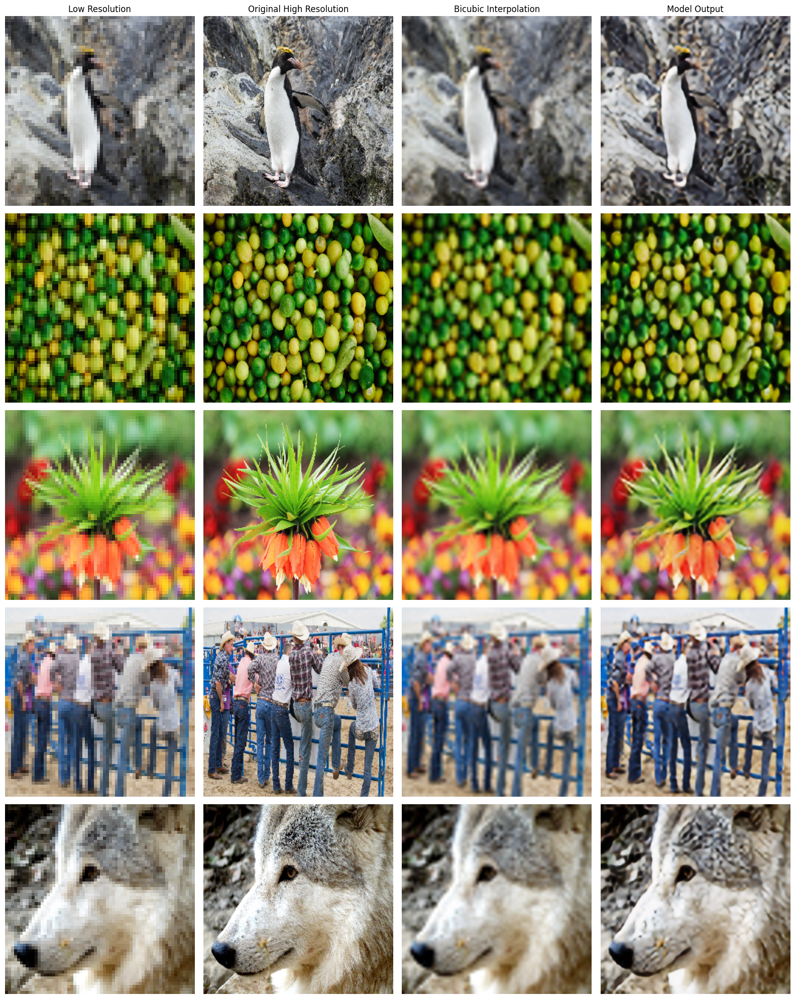

Model: model_epoch_30_psnr_20_12.pth
Bicubic Metrics: SNE: 2316.0557, PSNR: 0.7516, SSIM: 0.0213, LPIPS: 0.0224
Model Metrics: SNE: 2212.7484, PSNR: 0.7607, SSIM: 0.0238, LPIPS: 0.0176
----------------------------------------------------------------------------------------------------


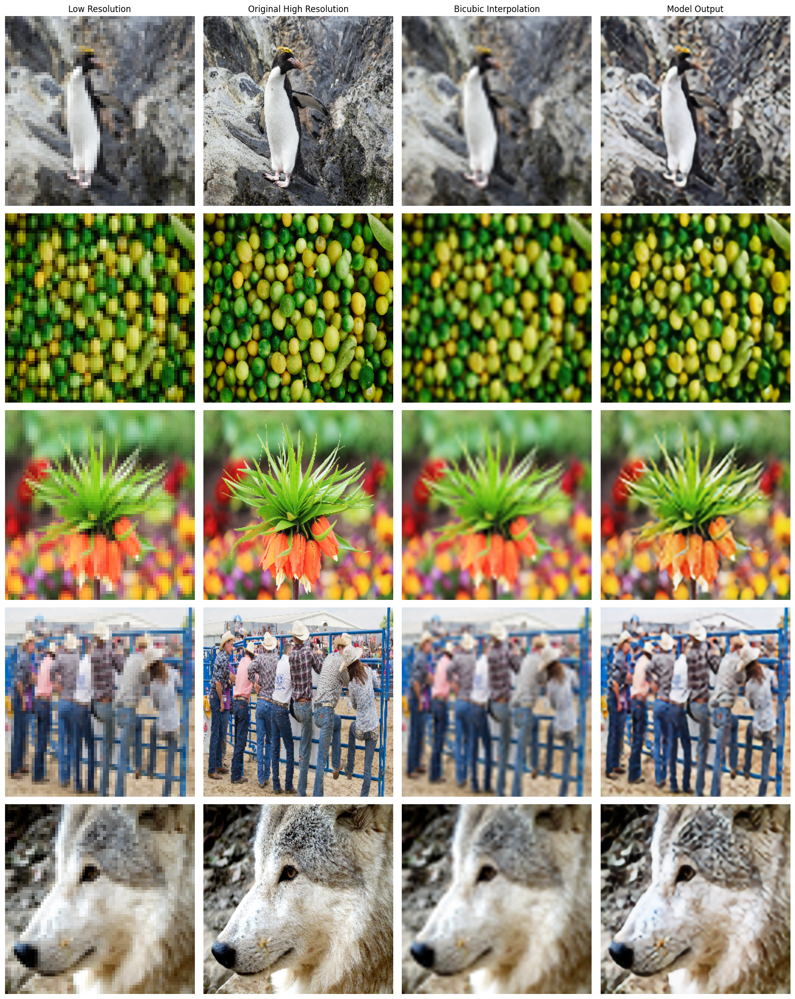

Model: model_epoch_22_psnr_20_08.pth
Bicubic Metrics: SNE: 2316.0557, PSNR: 0.7516, SSIM: 0.0213, LPIPS: 0.0224
Model Metrics: SNE: 2247.4265, PSNR: 0.7583, SSIM: 0.0235, LPIPS: 0.0180
----------------------------------------------------------------------------------------------------


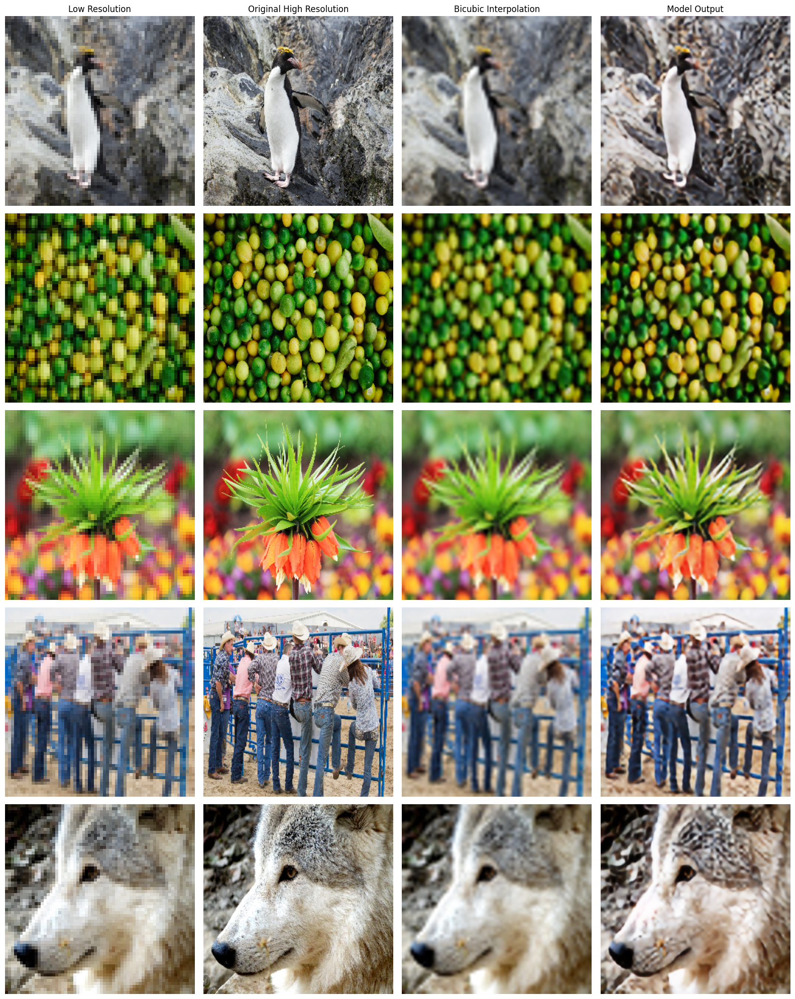

Model: model_epoch_38_psnr_20_07.pth
Bicubic Metrics: SNE: 2316.0557, PSNR: 0.7516, SSIM: 0.0213, LPIPS: 0.0224
Model Metrics: SNE: 2284.5527, PSNR: 0.7561, SSIM: 0.0240, LPIPS: 0.0174
----------------------------------------------------------------------------------------------------


In [ ]:
for model_name in best_models_64:
    params_path = os.path.join(*model_name.split("/")[:-1], "params.json")
    with open(params_path, "r") as f:
        params = json.load(f)
    scale = params["hr_size"][0] // params["lr_size"][0]
    model = UpscalingModel(scale, params['num_residual_blocks'], params['n_channels'])

    model.load_state_dict(torch.load(model_name))
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    n_images_display = 5
    bicubic_metrics, model_metrics = evaluate_model(valid_dataloader, model, n_images=n_images_display)

    print(f"Model: {model_name.split('/')[-1]}")
    print(f"Bicubic Metrics: {bicubic_metrics}")
    print(f"Model Metrics: {model_metrics}")
    print('-' * 100)


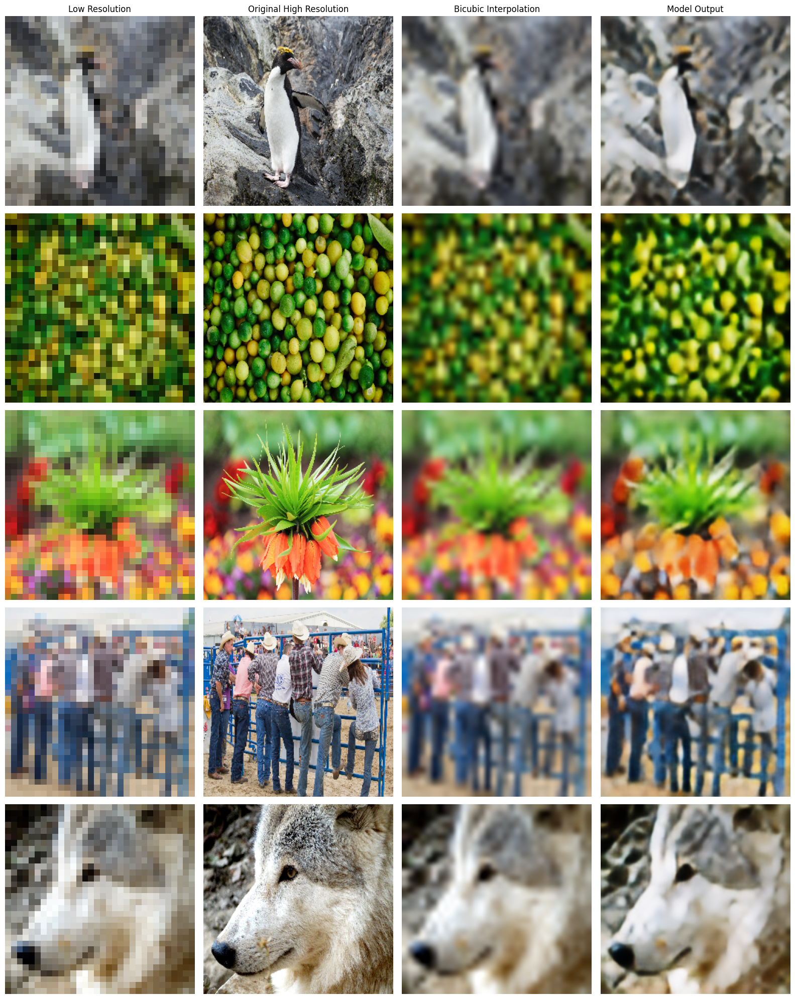

Model: model_epoch_38_psnr_18_04.pth
Bicubic Metrics: SNE: 3314.0104, PSNR: 1.2305, SSIM: 0.0278, LPIPS: 0.0534
Model Metrics: SNE: 3248.2572, PSNR: 1.2370, SSIM: 0.0296, LPIPS: 0.0449
--------------------------------------------------


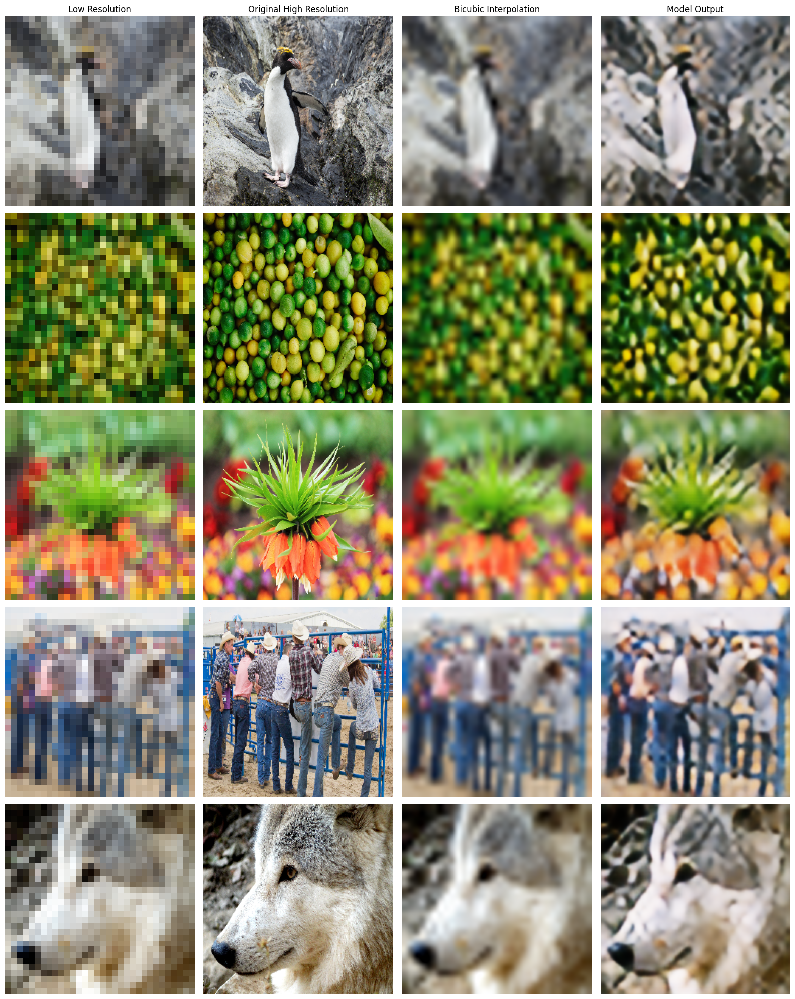

Model: model_epoch_24_psnr_18_03.pth
Bicubic Metrics: SNE: 3314.0104, PSNR: 1.2305, SSIM: 0.0278, LPIPS: 0.0534
Model Metrics: SNE: 3296.5470, PSNR: 1.2326, SSIM: 0.0297, LPIPS: 0.0463
--------------------------------------------------


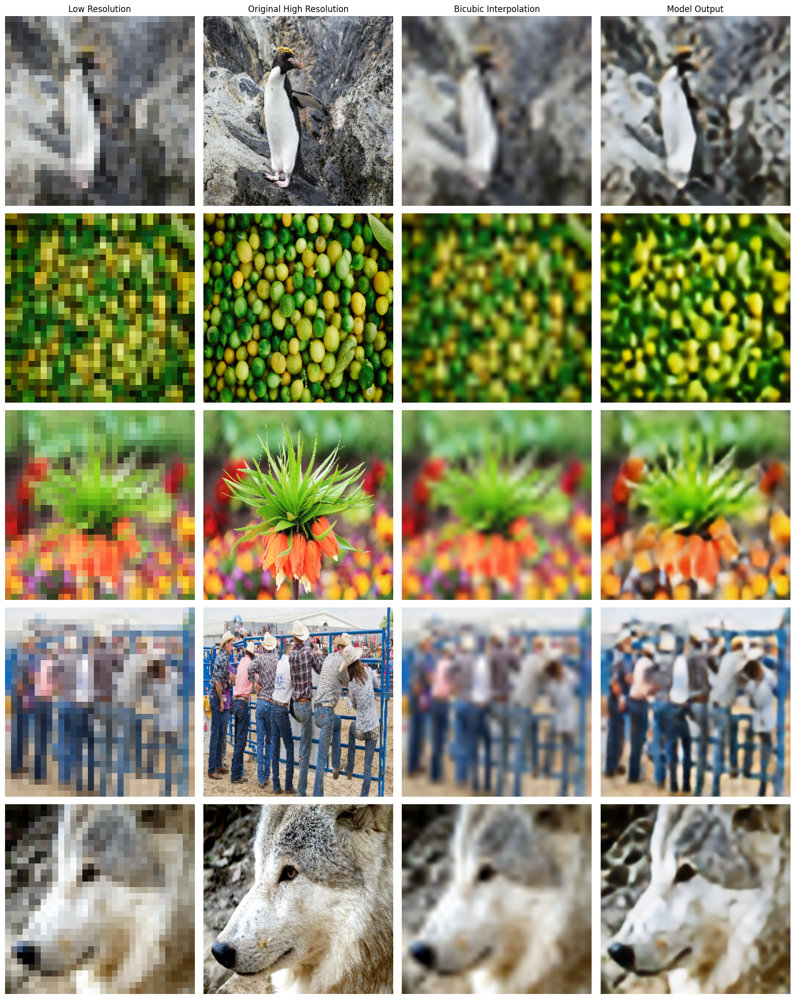

Model: model_epoch_36_psnr_18_01.pth
Bicubic Metrics: SNE: 3314.0104, PSNR: 1.2305, SSIM: 0.0278, LPIPS: 0.0534
Model Metrics: SNE: 3321.7207, PSNR: 1.2306, SSIM: 0.0298, LPIPS: 0.0449
--------------------------------------------------


In [ ]:
for model_name in best_models_32:
    params_path = os.path.join(*model_name.split("/")[:-1], "params.json")
    with open(params_path, "r") as f:
        params = json.load(f)
    scale = params["hr_size"][0] // params["lr_size"][0]
    model = UpscalingModel(scale, params['num_residual_blocks'], params['n_channels'])

    model.load_state_dict(torch.load(model_name))
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    n_images_display = 5
    bicubic_metrics, model_metrics = evaluate_model(valid_dataloader, model, n_images=n_images_display)

    print(f"Model: {model_name.split('/')[-1]}")
    print(f"Bicubic Metrics: {bicubic_metrics}")
    print(f"Model Metrics: {model_metrics}")
    print('-' * 50)


In [ ]:
def extract_results_data(models_dir_head, lr_size):
    result_paths = [
        os.path.join(models_dir_head, model, "results.json")
        for model in os.listdir(models_dir_head)
        if f"size_{lr_size}" in model
    ]

    all_results = {}
    for result_path in result_paths:
        with open(result_path, "r") as f:
            results = json.load(f)
        model_name = result_path.split("/")[-2].split("_2025-03-17")[0]
        results = [{**d, **d["metrics"]} for d in results]
        processed_results = {k: [d[k] for d in results] for k in results[0]}        
        all_results[model_name] = processed_results
    return all_results


In [ ]:
data_32 = extract_results_data("models", 32)
data_64 = extract_results_data("models", 64)


In [ ]:
def draw_learning_plots(data):
    wyniki = ["loss", "valid_loss", "SNE", "PSNR", "SSIM", "LPIPS"]

    # Ustawienie figury: 3 wiersze, 2 kolumny
    fig, axes = plt.subplots(nrows=3, ncols=2, figsize=(15, 20))
    fig.suptitle("Porównanie modeli w zależności od epoki", fontsize=16)

    # Spłaszczenie tablicy osi dla łatwiejszej iteracji
    axes = axes.flatten()

    # Iteracja po każdym wyniku i odpowiadającym mu wykresowi
    for idx, metryka in enumerate(wyniki):
        ax = axes[idx]
        # Rysowanie danych dla każdego modelu
        for model_name, slownik_list in data.items():
            ax.plot(
                slownik_list["epoch"],
                slownik_list[metryka],
                marker="o",
                label=model_name,
            )
        ax.set_title(metryka)
        ax.set_xlabel("Epoch")
        ax.set_ylabel(metryka)
        ax.legend()
        ax.grid(True)

    # Dopasowanie układu
    plt.tight_layout()
    plt.subplots_adjust(top=0.9)  # Miejsce na główny tytuł
    plt.show()


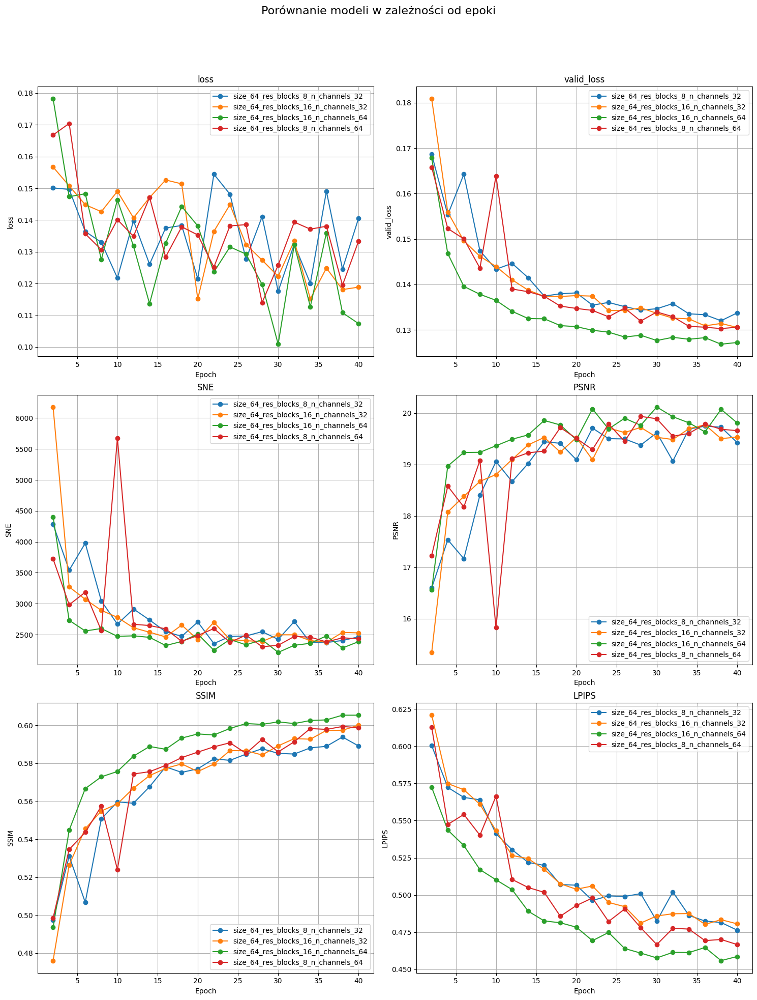

In [ ]:
draw_learning_plots(data_64)


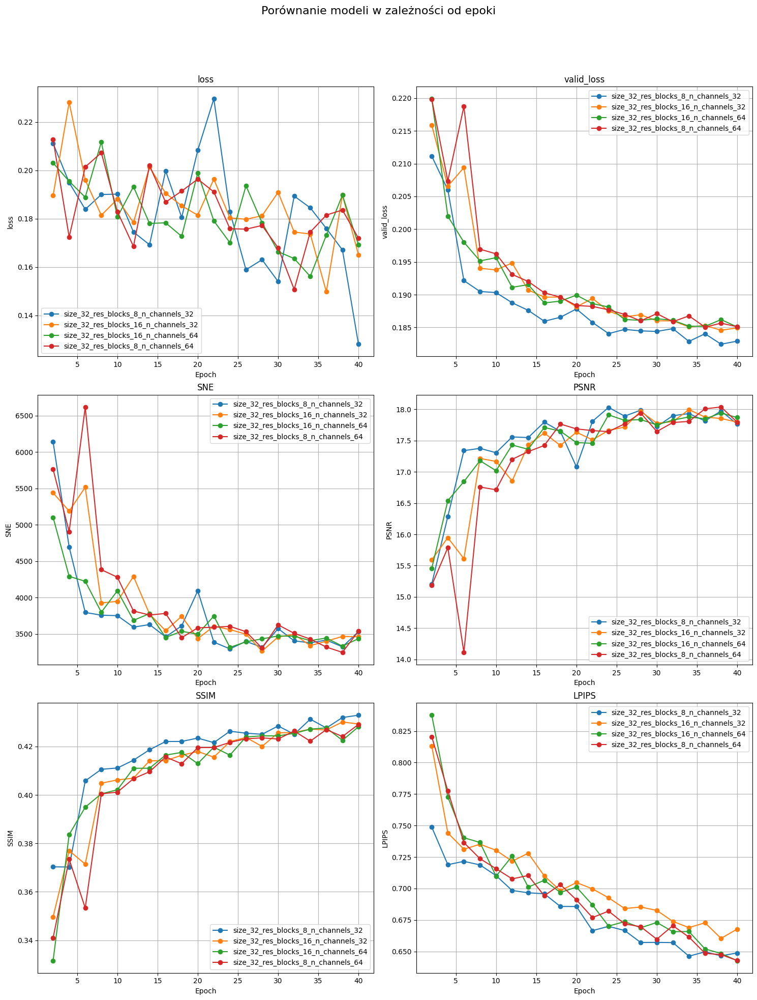

In [ ]:
draw_learning_plots(data_32)
